In [9]:
import scanpy as sc
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns

import os
import re

In [2]:
import matplotlib as mpl
mpl.rcParams.update(mpl.rcParamsDefault) #Reset rcParams to default

# Editable text and proper LaTeX fonts in illustrator
# matplotlib.rcParams['ps.useafm'] = True
# Editable fonts. 42 is the magic number
mpl.rcParams['pdf.fonttype'] = 42
sns.set(style='whitegrid', context='paper')

# Plotting style function (run this before plotting the final figure)
def set_plotting_style():
    plt.style.use('seaborn-paper')
    plt.rc('axes', labelsize=12)
    plt.rc('axes', titlesize=12)
    plt.rc('xtick', labelsize=10)
    plt.rc('ytick', labelsize=10)
    plt.rc('legend', fontsize=10)
    plt.rc('text.latex', preamble=r'\usepackage{sfmath}')
    plt.rc('xtick.major', pad=2)
    plt.rc('ytick.major', pad=2)
    plt.rc('mathtext', fontset='stixsans', sf='sansserif')
    plt.rc('figure', figsize=[10,9])
    plt.rc('svg', fonttype='none')

In [62]:
# # visualization settings
# %config InlineBackend.figure_format = 'retina'
# %matplotlib inline

# plt.rcParams['figure.figsize'] = [6, 4.5]
# plt.rcParams["savefig.dpi"] = 300

In [3]:
figpath = "/hpc/projects/data.science/yangjoon.kim/zebrahub_multiome/zebrahub-multiome-analysis/figures/QC_plots/"
os.makedirs(figpath, exist_ok=True)
sc.settings.figdir = figpath

In [4]:
adata = sc.read_h5ad("/hpc/projects/data.science/yangjoon.kim/zebrahub_multiome/data/processed_data/01_Signac_processed/integrated_RNA_ATAC_counts_RNA_formatted_excxg_zscape_labels.h5ad")
adata

AnnData object with n_obs × n_vars = 95196 × 32057
    obs: 'orig_ident', 'nCount_RNA', 'nFeature_RNA', 'nCount_ATAC', 'nFeature_ATAC', 'nucleosome_signal', 'nucleosome_percentile', 'TSS_enrichment', 'TSS_percentile', 'nCount_SCT', 'nFeature_SCT', 'global_annotation', 'nCount_peaks_bulk', 'nFeature_peaks_bulk', 'nCount_peaks_celltype', 'nFeature_peaks_celltype', 'nCount_peaks_merged', 'nFeature_peaks_merged', 'SCT_weight', 'peaks_merged_weight', 'nCount_Gene_Activity', 'nFeature_Gene_Activity', 'nCount_peaks_integrated', 'nFeature_peaks_integrated', 'dataset', 'integrated_weight', 'peaks_integrated_weight', 'wsnn_res_0_8', 'seurat_clusters', 'data_source', 'annotation_ML', 'scANVI_zscape'
    var: 'features'
    uns: 'annotation_ML_colors', 'dataset_colors', 'global_annotation_colors', 'log1p', 'scANVI_zscape_colors'
    obsm: 'X_umap', 'X_umap.atac', 'X_umap.rna', 'X_wnn.umap'
    layers: 'counts'

In [22]:
annotation = pd.read_csv("/hpc/projects/data.science/yangjoon.kim/zebrahub_multiome/data/processed_data/01_Signac_processed/annotations/annotation_ML_05292024.txt", index_col=0, sep="\t")
annotation

,annotation_ML
AAACAGCCACCTAAGC-1_1,epidermis
AAACAGCCAGGGAGGA-1_1,pronephros
AAACAGCCATAGACCC-1_1,hindbrain
AAACATGCAAACTCAT-1_1,axial_mesoderm
AAACATGCAAGGACCA-1_1,neural_optic2
...,...
TTTGTGTTCCCTCAGT-1_7,tail_bud
TTTGTTGGTACCTTAC-1_7,lateral_plate_mesoderm
TTTGTTGGTATTGAGT-1_7,neural_posterior
TTTGTTGGTGCGCGTA-1_7,endocrine_pancreas


In [23]:
adata.obs["annotation_ML"] = annotation["annotation_ML"]
adata.obs["annotation_ML"]

AAACAGCCACCTAAGC-1_1                 epidermis
AAACAGCCAGGGAGGA-1_1                pronephros
AAACAGCCATAGACCC-1_1                 hindbrain
AAACATGCAAACTCAT-1_1            axial_mesoderm
AAACATGCAAGGACCA-1_1             neural_optic2
                                 ...          
TTTGTGTTCCCTCAGT-1_7                  tail_bud
TTTGTTGGTACCTTAC-1_7    lateral_plate_mesoderm
TTTGTTGGTATTGAGT-1_7          neural_posterior
TTTGTTGGTGCGCGTA-1_7        endocrine_pancreas
TTTGTTGGTTAAGGCC-1_7                   somites
Name: annotation_ML, Length: 95196, dtype: object

In [27]:
# filter out the low quality cells (annotated as either "nan" or "low_quality_cells")
multiome = adata[adata.obs.annotation_ML!="low_quality_cells"]

In [28]:
# create a list of celltypes from annotation_ML (fine annotation by Merlin Lange)
list_celltypes_ML = multiome.obs.annotation_ML.unique().tolist()

In [29]:
# Remove NaNs from the list
elements = [el for el in list_celltypes_ML if isinstance(el, str)]

# Function to remove numbers
def remove_numbers(name):
    return re.sub(r'\d+', '', name)

# Create the dictionary
merged_dict = {}
for element in elements:
    merged_dict[element] = remove_numbers(element)

# for element in elements:
#     key = remove_numbers(element)
#     if key not in merged_dict:
#         merged_dict[key] = []
#     merged_dict[key].append(element)

# import ace_tools as tools; tools.display_dict_to_user("Merged Categories Dictionary", merged_dict)

# Display the dictionary
merged_dict

{'epidermis': 'epidermis',
 'pronephros': 'pronephros',
 'hindbrain': 'hindbrain',
 'axial_mesoderm': 'axial_mesoderm',
 'neural_optic2': 'neural_optic',
 'neural_floor_plate': 'neural_floor_plate',
 'neural_crest2': 'neural_crest',
 'PSM': 'PSM',
 'optic_cup': 'optic_cup',
 'lateral_plate_mesoderm': 'lateral_plate_mesoderm',
 'midbrain_hindbrain_boundary2': 'midbrain_hindbrain_boundary',
 'neural_telencephalon': 'neural_telencephalon',
 'differentiating_neurons': 'differentiating_neurons',
 'muscle': 'muscle',
 'fast_muscle': 'fast_muscle',
 'heart_myocardium': 'heart_myocardium',
 'somites': 'somites',
 'NMPs': 'NMPs',
 'epidermis2': 'epidermis',
 'pharyngeal_arches': 'pharyngeal_arches',
 'floor_plate2': 'floor_plate',
 'hemangioblasts': 'hemangioblasts',
 'neural_posterior': 'neural_posterior',
 'floor_plate': 'floor_plate',
 'tail_bud': 'tail_bud',
 'endoderm': 'endoderm',
 'midbrain_hindbrain_boundary': 'midbrain_hindbrain_boundary',
 'neural_crest': 'neural_crest',
 'neural_opti

In [30]:
# generate a coarse-grained annotation - "annotation_ML_coarse"
multiome.obs["annotation_ML_coarse"] = multiome.obs["annotation_ML"].map(merged_dict)

multiome.obs["annotation_ML_coarse"]

/tmp/ipykernel_502027/1848327900.py:2: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  multiome.obs["annotation_ML_coarse"] = multiome.obs["annotation_ML"].map(merged_dict)


AAACAGCCACCTAAGC-1_1                 epidermis
AAACAGCCAGGGAGGA-1_1                pronephros
AAACAGCCATAGACCC-1_1                 hindbrain
AAACATGCAAACTCAT-1_1            axial_mesoderm
AAACATGCAAGGACCA-1_1              neural_optic
                                 ...          
TTTGTGTTCCCTCAGT-1_7                  tail_bud
TTTGTTGGTACCTTAC-1_7    lateral_plate_mesoderm
TTTGTTGGTATTGAGT-1_7          neural_posterior
TTTGTTGGTGCGCGTA-1_7        endocrine_pancreas
TTTGTTGGTTAAGGCC-1_7                   somites
Name: annotation_ML_coarse, Length: 94562, dtype: object

In [31]:
multiome.obs["annotation_ML_coarse"].unique()

array(['epidermis', 'pronephros', 'hindbrain', 'axial_mesoderm',
       'neural_optic', 'neural_floor_plate', 'neural_crest', 'PSM',
       'optic_cup', 'lateral_plate_mesoderm',
       'midbrain_hindbrain_boundary', 'neural_telencephalon',
       'differentiating_neurons', 'muscle', 'fast_muscle',
       'heart_myocardium', 'somites', 'NMPs', 'pharyngeal_arches',
       'floor_plate', 'hemangioblasts', 'neural_posterior', 'tail_bud',
       'endoderm', 'hematopoietic_vasculature', 'endocrine_pancreas',
       'hatching_gland', 'neurons', 'notochord', 'enteric_neurons',
       'neural_unknown', 'primordial_germ_cells'], dtype=object)

In [32]:
multiome

AnnData object with n_obs × n_vars = 94562 × 32057
    obs: 'orig_ident', 'nCount_RNA', 'nFeature_RNA', 'nCount_ATAC', 'nFeature_ATAC', 'nucleosome_signal', 'nucleosome_percentile', 'TSS_enrichment', 'TSS_percentile', 'nCount_SCT', 'nFeature_SCT', 'global_annotation', 'nCount_peaks_bulk', 'nFeature_peaks_bulk', 'nCount_peaks_celltype', 'nFeature_peaks_celltype', 'nCount_peaks_merged', 'nFeature_peaks_merged', 'SCT_weight', 'peaks_merged_weight', 'nCount_Gene_Activity', 'nFeature_Gene_Activity', 'nCount_peaks_integrated', 'nFeature_peaks_integrated', 'dataset', 'integrated_weight', 'peaks_integrated_weight', 'wsnn_res_0_8', 'seurat_clusters', 'data_source', 'annotation_ML', 'scANVI_zscape', 'annotation_ML_coarse'
    var: 'features'
    uns: 'annotation_ML_colors', 'dataset_colors', 'global_annotation_colors', 'log1p', 'scANVI_zscape_colors'
    obsm: 'X_umap', 'X_umap.atac', 'X_umap.rna', 'X_wnn.umap'
    layers: 'counts'

In [34]:
# del multiome.obsm["X_umap"]
multiome

AnnData object with n_obs × n_vars = 94562 × 32057
    obs: 'orig_ident', 'nCount_RNA', 'nFeature_RNA', 'nCount_ATAC', 'nFeature_ATAC', 'nucleosome_signal', 'nucleosome_percentile', 'TSS_enrichment', 'TSS_percentile', 'nCount_SCT', 'nFeature_SCT', 'global_annotation', 'nCount_peaks_bulk', 'nFeature_peaks_bulk', 'nCount_peaks_celltype', 'nFeature_peaks_celltype', 'nCount_peaks_merged', 'nFeature_peaks_merged', 'SCT_weight', 'peaks_merged_weight', 'nCount_Gene_Activity', 'nFeature_Gene_Activity', 'nCount_peaks_integrated', 'nFeature_peaks_integrated', 'dataset', 'integrated_weight', 'peaks_integrated_weight', 'wsnn_res_0_8', 'seurat_clusters', 'data_source', 'annotation_ML', 'scANVI_zscape', 'annotation_ML_coarse'
    var: 'features'
    uns: 'annotation_ML_colors', 'dataset_colors', 'global_annotation_colors', 'log1p', 'scANVI_zscape_colors'
    obsm: 'X_umap.atac', 'X_umap.rna', 'X_wnn.umap'
    layers: 'counts'

In [6]:
# # filter out the "unassigned" cells annnotated from the zebrahub label transfer.
# adata = adata[adata.obs["global_annotation"]!="unassigned"]

In [8]:
# set the color palettes using "Set3"
# Cell types
cell_types = [
    'Epidermal', 'Lateral_Mesoderm', 'PSM', 'Neural_Posterior',
    'Neural_Anterior', 'Neural_Crest', 'Differentiating_Neurons',
    'Adaxial_Cells', 'Muscle', 'Somites', 'Endoderm', 'Notochord',
    'NMPs'
]

# Generate "Set3" color palette
set3_palette = sns.color_palette("Set3", n_colors=len(cell_types))

# Suppose the light yellow is the 10th color in the palette (9th index, as indexing is 0-based)
# and you want to replace it with teal color
teal_color = (0.0, 0.5019607843137255, 0.5019607843137255)  # RGB for teal
set3_palette[1] = teal_color  # Replace the light yellow with teal

# Assign colors to cell types
custom_palette = {cell_type: color for cell_type, color in zip(cell_types, set3_palette)}
# Change the color for 'NMPs' to a dark blue
custom_palette['NMPs'] = (0.12941176470588237, 0.4, 0.6745098039215687)  # Dark blue color

/hpc/user_apps/data.science/conda_envs/single-cell-base/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:1234: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
/hpc/user_apps/data.science/conda_envs/single-cell-base/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


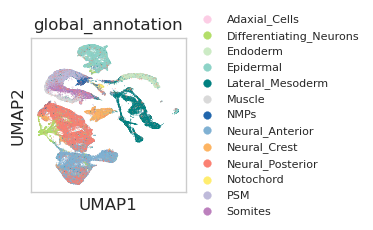

In [68]:
# UMAP (integrated_ATAC) colored by the cell types (transferred from zebrahub)
with plt.rc_context({"figure.figsize": (2, 2), "figure.dpi": (100)}):
    sc.pl.umap(adata, color=["global_annotation"], palette=custom_palette,
               legend_fontsize=8,save="_integrated_ATAC_celltypes.pdf")

/hpc/user_apps/data.science/conda_envs/single-cell-base/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:1234: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
/hpc/user_apps/data.science/conda_envs/single-cell-base/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


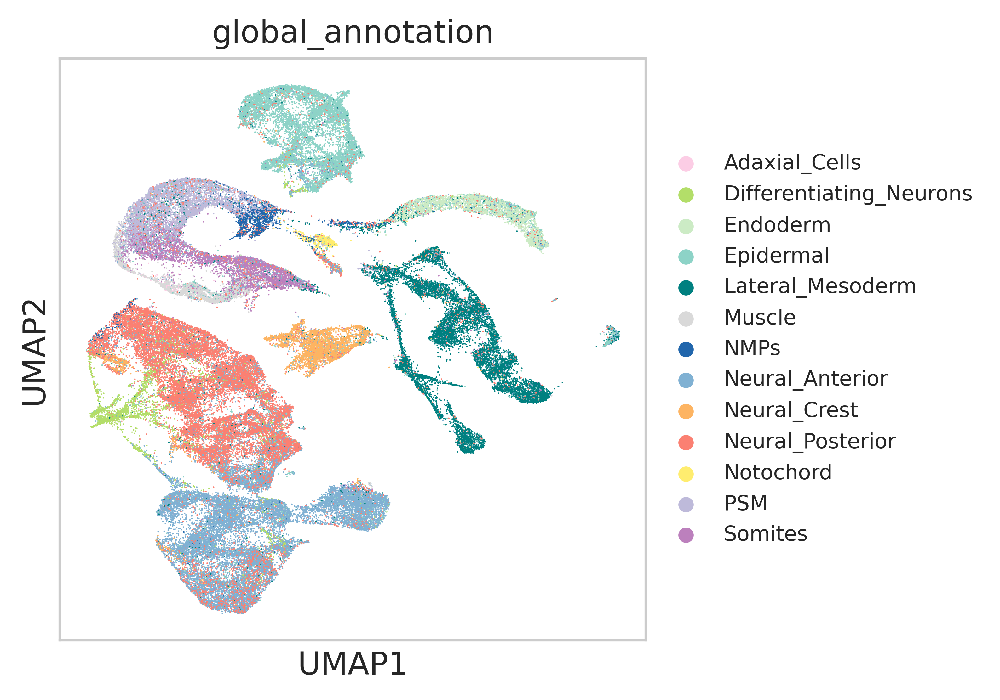

In [69]:
# UMAP (integrated_ATAC) colored by the cell types (transferred from zebrahub)
with plt.rc_context({"figure.figsize": (4, 4), "figure.dpi": (600)}):
    sc.pl.umap(adata, color=["global_annotation"], palette=custom_palette,
               legend_fontsize=8,save="_integrated_ATAC_celltypes.png")

In [11]:
# shuffle the cell ordering in the adata (and make a copied adata object just fot plotting)
np.random.seed(42)
shuffled_indices = np.random.permutation(adata.n_obs)

adata_shuffled = adata[shuffled_indices].copy()
adata_shuffled.obsm["X_umap"] = adata.obsm["X_umap"][shuffled_indices]

/hpc/user_apps/data.science/conda_envs/single-cell-base/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:1234: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
/hpc/user_apps/data.science/conda_envs/single-cell-base/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


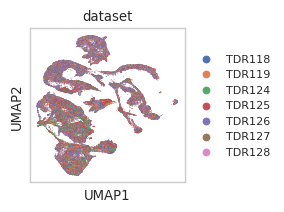

In [13]:
# UMAP (integrated_ATAC) colored with batch
with plt.rc_context({"figure.figsize": (2, 2), "figure.dpi": (100)}):
    sc.pl.umap(adata_shuffled, color=["dataset"],
               legend_fontsize=8,save="_integrated_ATAC_batch.pdf")

/hpc/user_apps/data.science/conda_envs/single-cell-base/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:1234: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
/hpc/user_apps/data.science/conda_envs/single-cell-base/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


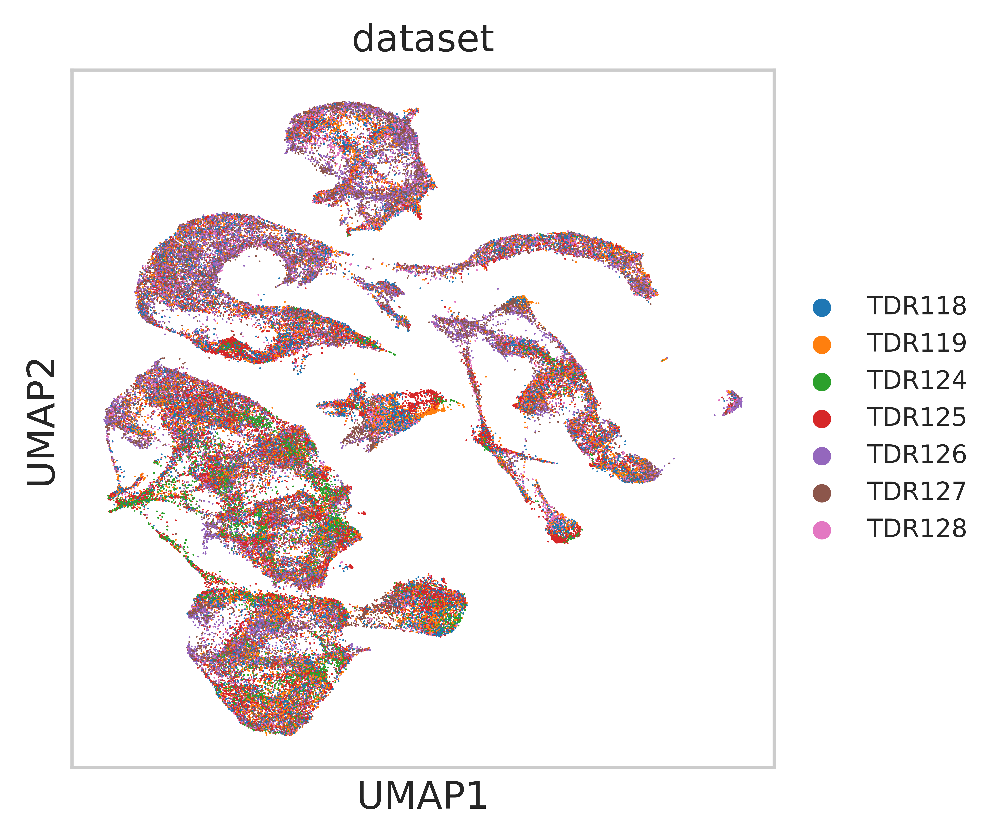

In [111]:
# UMAP (integrated_ATAC) colored with batch
with plt.rc_context({"figure.figsize": (4, 4), "figure.dpi": (600)}):
    sc.pl.umap(adata_shuffled, color=["dataset"],
               legend_fontsize=8,save="_integrated_ATAC_batch.png")

In [9]:
dict_dev_stages = {
    "TDR118":"15somites",
    "TDR119":"15somites",
    "TDR124":"30somites",
    "TDR125":"20somites",
    "TDR126":"0somites",
    "TDR127":"5somites",
    "TDR128":"10somites"
}

In [10]:
adata.obs["dev_stage"] = adata.obs["dataset"].map(dict_dev_stages)
adata.obs["dev_stage"]

/tmp/ipykernel_886846/345792824.py:1: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  adata.obs["dev_stage"] = adata.obs["dataset"].map(dict_dev_stages)


AAACAGCCACCTAAGC-1_1    15somites
AAACAGCCAGGGAGGA-1_1    15somites
AAACAGCCATAGACCC-1_1    15somites
AAACATGCAAACTCAT-1_1    15somites
AAACATGCAAGGACCA-1_1    15somites
                          ...    
TTTGTGTTCCCTCAGT-1_7    10somites
TTTGTTGGTACCTTAC-1_7    10somites
TTTGTTGGTATTGAGT-1_7    10somites
TTTGTTGGTGCGCGTA-1_7    10somites
TTTGTTGGTTAAGGCC-1_7    10somites
Name: dev_stage, Length: 90630, dtype: object

In [11]:
# colormap
# Define the timepoints
timepoints = ["0somites", "5somites", "10somites", "15somites", "20somites", "30somites"]

# Load the "viridis" colormap
viridis = plt.cm.get_cmap('viridis', 256)

# Select a subset of the colormap to ensure that "30 somites" is yellow
# You can adjust the start and stop indices to shift the colors
start = 50
stop = 256
colors = viridis(np.linspace(start/256, stop/256, len(timepoints)))

# Create a dictionary to map timepoints to colors
color_dict = dict(zip(timepoints, colors))
color_dict

/tmp/ipykernel_886846/1126490073.py:6: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  viridis = plt.cm.get_cmap('viridis', 256)


{'0somites': array([0.255645, 0.260703, 0.528312, 1.      ]),
 '5somites': array([0.180629, 0.429975, 0.557282, 1.      ]),
 '10somites': array([0.123463, 0.581687, 0.547445, 1.      ]),
 '15somites': array([0.226397, 0.728888, 0.462789, 1.      ]),
 '20somites': array([0.575563, 0.844566, 0.256415, 1.      ]),
 '30somites': array([0.993248, 0.906157, 0.143936, 1.      ])}

/hpc/user_apps/data.science/conda_envs/single-cell-base/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:1234: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
/hpc/user_apps/data.science/conda_envs/single-cell-base/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


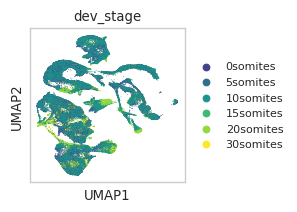

In [26]:
# UMAP (integrated_ATAC) colored with dev_stage
with plt.rc_context({"figure.figsize": (2, 2), "figure.dpi": (100)}):
    sc.pl.umap(adata, color=["dev_stage"], palette=color_dict,
               legend_fontsize=8,save="_integrated_ATAC_dev_stage.pdf")

/hpc/user_apps/data.science/conda_envs/single-cell-base/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:1234: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
/hpc/user_apps/data.science/conda_envs/single-cell-base/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


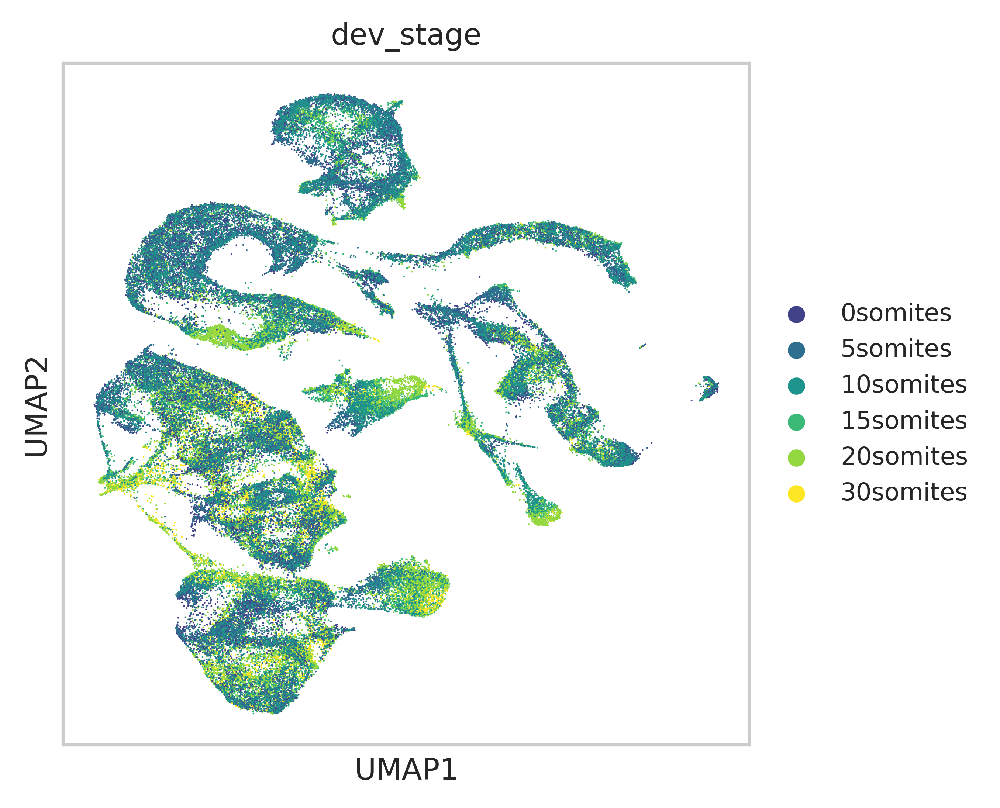

In [25]:
# UMAP (integrated_ATAC) colored with dev_stage
with plt.rc_context({"figure.figsize": (4, 4), "figure.dpi": (600)}):
    sc.pl.umap(adata, color=["dev_stage"], palette=color_dict,
               legend_fontsize=8,save="_integrated_ATAC_dev_stage.png")

In [13]:
# Calculate the count of each cell-type within each dataset
cell_type_counts = adata.obs.groupby(['dataset', 'global_annotation']).size().unstack(fill_value=0)

# Calculate the fraction of each cell-type within each dataset
cell_type_fractions = cell_type_counts.div(cell_type_counts.sum(axis=1), axis=0)

In [14]:
cell_type_fractions

global_annotation,Adaxial_Cells,Differentiating_Neurons,Endoderm,Epidermal,Lateral_Mesoderm,Muscle,NMPs,Neural_Anterior,Neural_Crest,Neural_Posterior,Notochord,PSM,Somites
dataset,,,,,,,,,,,,,
TDR118,0.009570,0.023999,0.035998,0.110130,0.143846,0.033274,0.006699,0.320009,0.074205,0.127577,0.005963,0.057936,0.050795
TDR119,0.006427,0.023058,0.049409,0.158592,0.130955,0.016148,0.008677,0.306741,0.070941,0.126778,0.004017,0.058729,0.039528
TDR124,0.030447,0.108593,0.011333,0.191137,0.000000,0.014547,0.000000,0.098106,0.010995,0.481055,0.000169,0.012855,0.040765
TDR125,0.000000,0.038082,0.000755,0.105306,0.125508,0.051260,0.010972,0.265993,0.053117,0.279810,0.001974,0.026007,0.041217
TDR126,0.000000,0.017584,0.045588,0.136356,0.151661,0.018724,0.043146,0.196679,0.009769,0.195946,0.019131,0.093699,0.071719
TDR127,0.000000,0.016510,0.049424,0.133673,0.126825,0.014493,0.025747,0.240272,0.035834,0.198545,0.009715,0.100016,0.048946
TDR128,0.000000,0.018375,0.054932,0.159284,0.145841,0.030658,0.017408,0.105126,0.059091,0.286944,0.002901,0.073308,0.046132


In [15]:
# Prepare the DataFrame for plotting
data_for_plotting = cell_type_fractions.stack().reset_index()
data_for_plotting.columns = ['dataset', 'cell_type', 'fraction']

In [32]:
set_plotting_style()

/tmp/ipykernel_4489/1109582874.py:12: MatplotlibDeprecationWarning: The seaborn styles shipped by Matplotlib are deprecated since 3.6, as they no longer correspond to the styles shipped by seaborn. However, they will remain available as 'seaborn-v0_8-<style>'. Alternatively, directly use the seaborn API instead.
  plt.style.use('seaborn-paper')


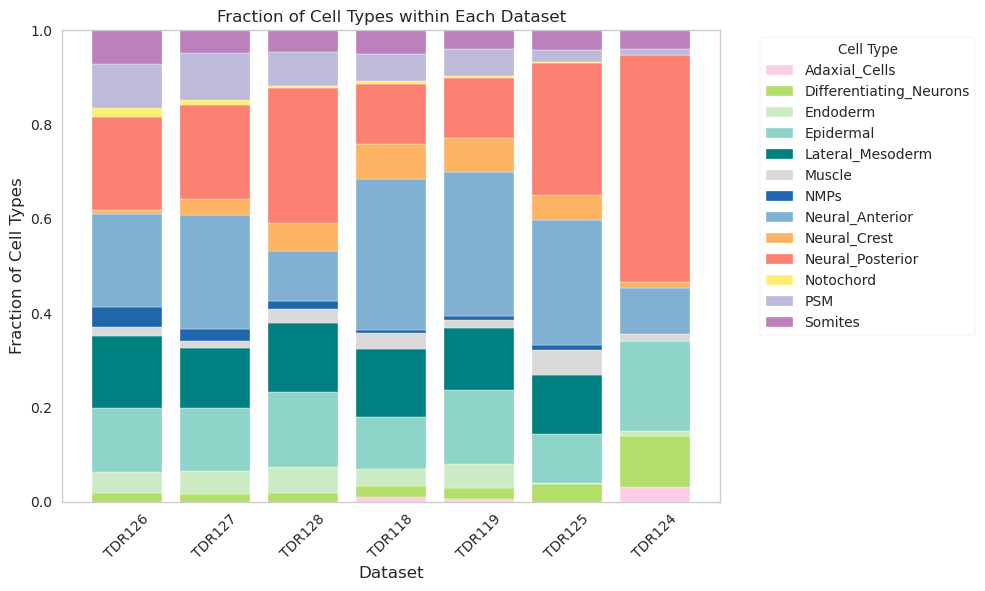

In [70]:
# order of the datasets
order_datasets = ["TDR126","TDR127","TDR128","TDR118","TDR119","TDR125","TDR124"]

# Reorder the DataFrame according to your specific dataset order
cell_type_fractions = cell_type_fractions.reindex(order_datasets)

# Unique datasets and cell-types
datasets = cell_type_fractions.index.tolist()
cell_types = cell_type_fractions.columns.tolist()

# Initialize the bottom parameter for stacking
bottom = pd.Series([0] * len(datasets), index=datasets)

# Plot each cell-type fraction
plt.figure(figsize=(10, 6))
for cell_type in cell_types:
    plt.bar(datasets, cell_type_fractions[cell_type], bottom=bottom, 
            label=cell_type, color=custom_palette[cell_type])
    bottom += cell_type_fractions[cell_type]

plt.xticks(rotation=45)
plt.ylabel('Fraction of Cell Types')
plt.xlabel('Dataset')
plt.title('Fraction of Cell Types within Each Dataset')
plt.ylim(0, 1)  # Ensure y-axis maxes at 1
# Remove grid lines
plt.grid(False)
plt.legend(title='Cell Type', bbox_to_anchor=(1.05, 1), loc='upper left')

plt.tight_layout()
plt.savefig(figpath + "frac_celltypes_timepoints.pdf")
plt.savefig(figpath + "frac_celltypes_timepoints.png")
plt.show()

In [80]:
cell_type_fractions['TDR118_TDR119_avg'] = cell_type_fractions.loc[['TDR118', 'TDR119']].mean()
cell_type_fractions

global_annotation,Adaxial_Cells,Differentiating_Neurons,Endoderm,Epidermal,Lateral_Mesoderm,Muscle,NMPs,Neural_Anterior,Neural_Crest,Neural_Posterior,Notochord,PSM,Somites,TDR118_TDR119_avg
dataset,,,,,,,,,,,,,,
TDR118,0.009570,0.023999,0.035998,0.110130,0.143846,0.033274,0.006699,0.320009,0.074205,0.127577,0.005963,0.057936,0.050795,NaN
TDR119,0.006427,0.023058,0.049409,0.158592,0.130955,0.016148,0.008677,0.306741,0.070941,0.126778,0.004017,0.058729,0.039528,NaN
TDR124,0.030447,0.108593,0.011333,0.191137,0.000000,0.014547,0.000000,0.098106,0.010995,0.481055,0.000169,0.012855,0.040765,NaN
TDR125,0.000000,0.038082,0.000755,0.105306,0.125508,0.051260,0.010972,0.265993,0.053117,0.279810,0.001974,0.026007,0.041217,NaN
TDR126,0.000000,0.017584,0.045588,0.136356,0.151661,0.018724,0.043146,0.196679,0.009769,0.195946,0.019131,0.093699,0.071719,NaN
TDR127,0.000000,0.016510,0.049424,0.133673,0.126825,0.014493,0.025747,0.240272,0.035834,0.198545,0.009715,0.100016,0.048946,NaN
TDR128,0.000000,0.018375,0.054932,0.159284,0.145841,0.030658,0.017408,0.105126,0.059091,0.286944,0.002901,0.073308,0.046132,NaN


In [81]:
# plotting over the timecourse
# average the cell type frequencies between TDR118 and TDR119 (biological replicates)
# order of the datasets
order_datasets = ["TDR126","TDR127","TDR128","TDR118","TDR119","TDR125","TDR124"]

# Reorder the DataFrame according to your specific dataset order
cell_type_fractions = cell_type_fractions.reindex(order_datasets)

# Calculate the average of the fractions for TDR118 and TDR119
average_TDR118_TDR119 = cell_type_fractions.loc[['TDR118', 'TDR119']].mean(axis=0)

# Add the averaged fractions back into the DataFrame with a new label
cell_type_fractions.loc['TDR118_TDR119_avg'] = average_TDR118_TDR119

# Drop the original TDR118 and TDR119 rows
cell_type_fractions.drop(['TDR118', 'TDR119'], axis=0, inplace=True)

# Add the averaged column in the desired order
order_datasets_with_avg = ["TDR126","TDR127","TDR128","TDR118_TDR119_avg","TDR125","TDR124"]
cell_type_fractions = cell_type_fractions.reindex(order_datasets_with_avg)

# Dictionary for mapping datasets to developmental stages
dict_dev_stages_v2 = {
    'TDR118_TDR119_avg': '15somites',  # Add the averaged stage here
    'TDR124': '30somites',
    'TDR125': '20somites',
    'TDR126': '0somites',
    'TDR127': '5somites',
    'TDR128': '10somites'
}

# Rename the index using dict_dev_stages to reflect developmental stages
cell_type_fractions.rename(index=dict_dev_stages_v2, inplace=True)

KeyError: 'TDR118_TDR119_avg'

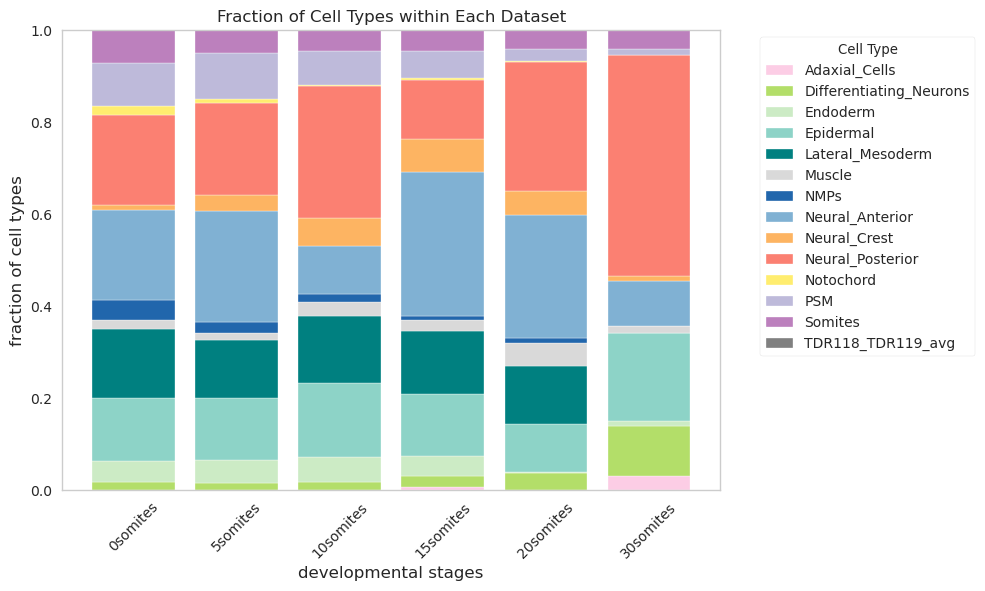

In [87]:
# Unique datasets and cell-types
datasets = cell_type_fractions.index.tolist()
cell_types = cell_type_fractions.columns.tolist()

# Initialize the bottom parameter for stacking
bottom = pd.Series([0] * len(datasets), index=datasets)

# Plot each cell-type fraction
plt.figure(figsize=(10, 6))
for cell_type in cell_types:
    # Use the get method to provide a default color if the key doesn't exist
    color = custom_palette.get(cell_type, "grey")  # Default color set to "grey"
    plt.bar(datasets, cell_type_fractions[cell_type],
            bottom=bottom, label=cell_type, color=color)
    bottom += cell_type_fractions[cell_type]

plt.xticks(rotation=45)
plt.ylabel('fraction of cell types')
plt.xlabel('developmental stages')
plt.title('Fraction of Cell Types within Each Dataset')
plt.ylim(0, 1)  # Ensure y-axis maxes at 1
# Remove grid lines
plt.grid(False)
plt.legend(title='Cell Type', bbox_to_anchor=(1.05, 1), loc='upper left')

plt.tight_layout()
# Replace 'figpath' with the actual path where you want to save the figures
plt.savefig(figpath + "frac_celltypes_dev_stages.pdf")
plt.savefig(figpath + "frac_celltypes_dev_stages.png")
plt.show()

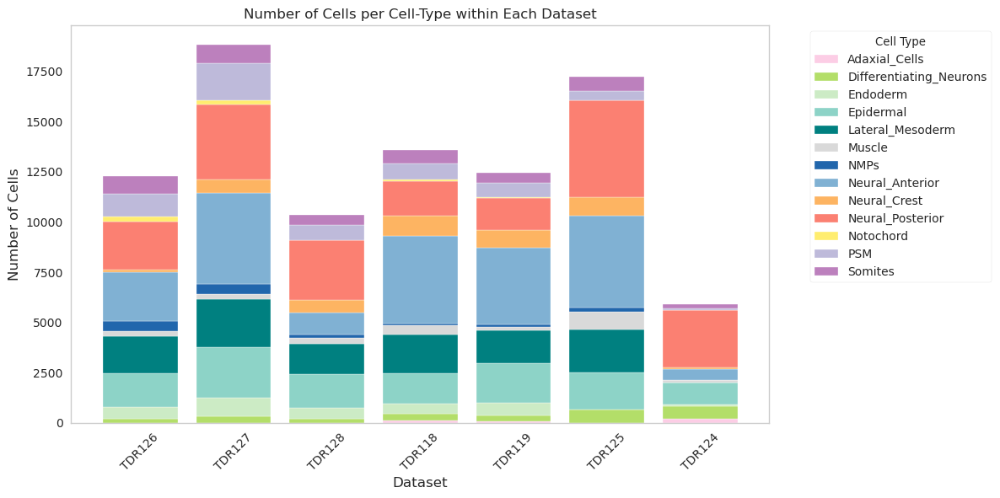

In [88]:
# Assuming you've already defined an appropriate color palette
# For this example, let's reuse the unique extended_set2_palette for coloring

order_datasets = ["TDR126","TDR127","TDR128","TDR118","TDR119","TDR125","TDR124"]

# Reorder the DataFrame according to your specific dataset order
cell_type_counts = cell_type_counts.reindex(order_datasets)

# Plot
plt.figure(figsize=(12, 6))
bottom = None
for cell_type in cell_type_counts.columns:
    # Check if bottom has been initialized
    if bottom is None:
        bottom = [0] * cell_type_counts.shape[0]
    plt.bar(cell_type_counts.index, cell_type_counts[cell_type], 
            bottom=bottom, label=cell_type, color=custom_palette[cell_type])
    # Update bottom for the next cell type
    bottom = [left + height for left, height in zip(bottom, cell_type_counts[cell_type])]

plt.xticks(rotation=45)
plt.ylabel('Number of Cells')
plt.xlabel('Dataset')
plt.title('Number of Cells per Cell-Type within Each Dataset')
# Remove grid lines
plt.grid(False)
plt.legend(title='Cell Type', bbox_to_anchor=(1.05, 1), loc='upper left')

plt.tight_layout()
plt.savefig(figpath + "num_celltypes_timepoints.pdf")
plt.savefig(figpath + "num_celltypes_timepoints.png")
plt.show()

## RNA modality

In [36]:
# import the RNA adata
adata_RNA = sc.read_h5ad("/hpc/projects/data.science/yangjoon.kim/zebrahub_multiome/data/processed_data/01_Signac_processed/integrated_RNA.h5ad")
adata_RNA

AnnData object with n_obs × n_vars = 95196 × 32057
    obs: 'orig.ident', 'nCount_RNA', 'nFeature_RNA', 'nCount_ATAC', 'nFeature_ATAC', 'nucleosome_signal', 'nucleosome_percentile', 'TSS.enrichment', 'TSS.percentile', 'nCount_SCT', 'nFeature_SCT', 'global_annotation', 'prediction.score.Lateral_Mesoderm', 'prediction.score.Neural_Crest', 'prediction.score.Somites', 'prediction.score.Epidermal', 'prediction.score.Neural_Anterior', 'prediction.score.Neural_Posterior', 'prediction.score.Endoderm', 'prediction.score.PSM', 'prediction.score.Differentiating_Neurons', 'prediction.score.Adaxial_Cells', 'prediction.score.NMPs', 'prediction.score.Notochord', 'prediction.score.Muscle', 'prediction.score.unassigned', 'prediction.score.max', 'nCount_peaks_bulk', 'nFeature_peaks_bulk', 'nCount_peaks_celltype', 'nFeature_peaks_celltype', 'nCount_peaks_merged', 'nFeature_peaks_merged', 'SCT.weight', 'peaks_merged.weight', 'nCount_Gene.Activity', 'nFeature_Gene.Activity', 'prediction.score.Germline', 'i

In [37]:
# filter out the "unassigned" from the zebrahub label transfer
# Of course, we'll have to check what these cells are later. For now, we think that these would be low quality cells/nuclei that survived from our initial QC.
adata_RNA = adata_RNA[adata_RNA.obs["global_annotation"]!="unassigned"]
adata_RNA

View of AnnData object with n_obs × n_vars = 90630 × 32057
    obs: 'orig.ident', 'nCount_RNA', 'nFeature_RNA', 'nCount_ATAC', 'nFeature_ATAC', 'nucleosome_signal', 'nucleosome_percentile', 'TSS.enrichment', 'TSS.percentile', 'nCount_SCT', 'nFeature_SCT', 'global_annotation', 'prediction.score.Lateral_Mesoderm', 'prediction.score.Neural_Crest', 'prediction.score.Somites', 'prediction.score.Epidermal', 'prediction.score.Neural_Anterior', 'prediction.score.Neural_Posterior', 'prediction.score.Endoderm', 'prediction.score.PSM', 'prediction.score.Differentiating_Neurons', 'prediction.score.Adaxial_Cells', 'prediction.score.NMPs', 'prediction.score.Notochord', 'prediction.score.Muscle', 'prediction.score.unassigned', 'prediction.score.max', 'nCount_peaks_bulk', 'nFeature_peaks_bulk', 'nCount_peaks_celltype', 'nFeature_peaks_celltype', 'nCount_peaks_merged', 'nFeature_peaks_merged', 'SCT.weight', 'peaks_merged.weight', 'nCount_Gene.Activity', 'nFeature_Gene.Activity', 'prediction.score.Germl

In [39]:
# transfer the dataset labels from ATAC to RNA
adata_RNA.obs["dataset"] = adata.obs["dataset"].values

/tmp/ipykernel_4489/1401388258.py:2: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  adata_RNA.obs["dataset"] = adata.obs["dataset"].values


In [40]:
dict_dev_stages = {
    "TDR118":"15somites",
    "TDR119":"15somites",
    "TDR124":"30somites",
    "TDR125":"20somites",
    "TDR126":"0somites",
    "TDR127":"5somites",
    "TDR128":"10somites"
}

In [41]:
adata_RNA.obs["dev_stage"] = adata_RNA.obs["dataset"].map(dict_dev_stages)
adata_RNA.obs["dev_stage"]

AAACAGCCACCTAAGC-1_1    15somites
AAACAGCCAGGGAGGA-1_1    15somites
AAACAGCCATAGACCC-1_1    15somites
AAACATGCAAACTCAT-1_1    15somites
AAACATGCAAGGACCA-1_1    15somites
                          ...    
TTTGTGTTCCCTCAGT-1_7    10somites
TTTGTTGGTACCTTAC-1_7    10somites
TTTGTTGGTATTGAGT-1_7    10somites
TTTGTTGGTGCGCGTA-1_7    10somites
TTTGTTGGTTAAGGCC-1_7    10somites
Name: dev_stage, Length: 90630, dtype: object

In [42]:
adata_RNA.obs.head()

,orig.ident,nCount_RNA,nFeature_RNA,nCount_ATAC,nFeature_ATAC,nucleosome_signal,nucleosome_percentile,TSS.enrichment,TSS.percentile,nCount_SCT,...,nFeature_peaks_merged,SCT.weight,peaks_merged.weight,nCount_Gene.Activity,nFeature_Gene.Activity,prediction.score.Germline,integrated_snn_res.0.5,seurat_clusters,dataset,dev_stage
AAACAGCCACCTAAGC-1_1,SeuratProject,6522.0,2317,21425.0,9781,0.571984,0.40,4.488213,0.48,5661.0,...,10714,0.493270,0.506730,12380.0,7106,NaN,0,0,TDR118,15somites
AAACAGCCAGGGAGGA-1_1,SeuratProject,6100.0,2319,10334.0,5028,0.448143,0.13,4.795205,0.75,5553.0,...,5563,0.498962,0.501038,6192.0,4256,NaN,19,7,TDR118,15somites
AAACAGCCATAGACCC-1_1,SeuratProject,12581.0,3467,51485.0,19874,0.514213,0.24,5.238692,0.92,5781.0,...,21333,0.572315,0.427685,26083.0,10345,NaN,12,2,TDR118,15somites
AAACATGCAAACTCAT-1_1,SeuratProject,5642.0,2145,19812.0,9183,0.673319,0.85,4.409525,0.41,5363.0,...,9939,0.481765,0.518235,11748.0,6534,NaN,1,1,TDR118,15somites
AAACATGCAAGGACCA-1_1,SeuratProject,2691.0,838,5182.0,2565,0.394904,0.06,4.939061,0.83,4727.0,...,2761,0.408465,0.591535,3061.0,2376,NaN,15,3,TDR118,15somites


/hpc/user_apps/data.science/conda_envs/single-cell-base/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:1234: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
/hpc/user_apps/data.science/conda_envs/single-cell-base/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


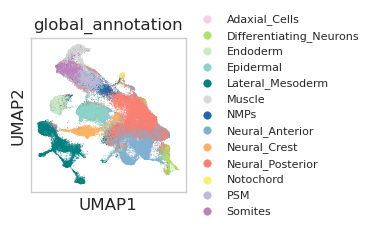

In [89]:
# UMAP (integrated_RNA) colored with "celltype annotation"
with plt.rc_context({"figure.figsize": (2, 2), "figure.dpi": (100)}):
    sc.pl.umap(adata_RNA, color=["global_annotation"], palette=custom_palette,
               legend_fontsize=8,save="_integrated_rna_celltype.pdf")

/hpc/user_apps/data.science/conda_envs/single-cell-base/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:1234: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
/hpc/user_apps/data.science/conda_envs/single-cell-base/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


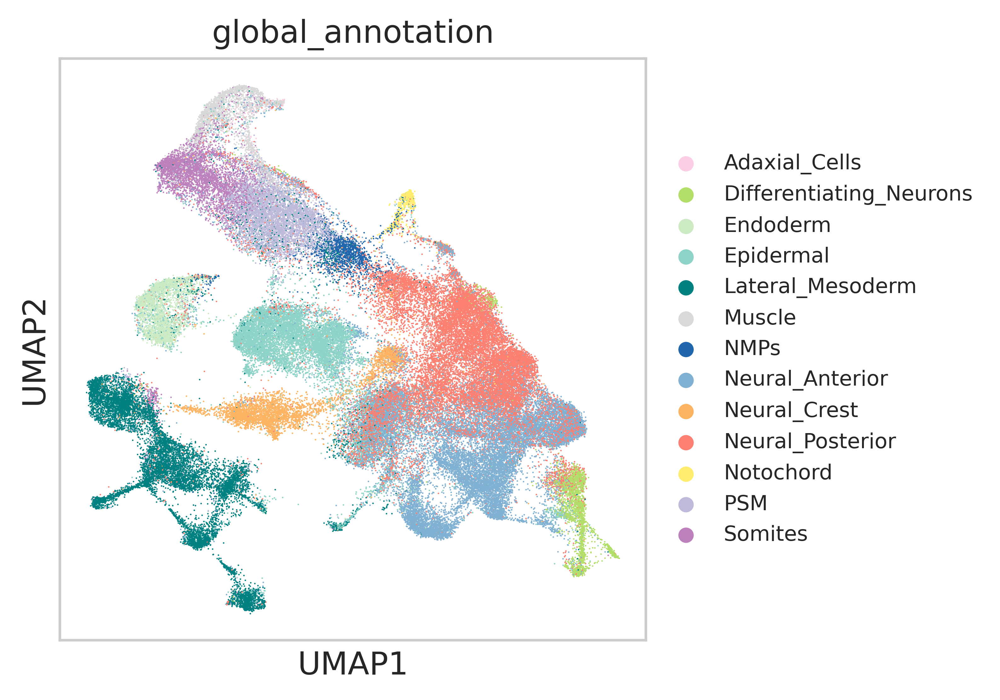

In [91]:
# UMAP (integrated_RNA) colored with "celltype annotation"
with plt.rc_context({"figure.figsize": (4, 4), "figure.dpi": (600)}):
    sc.pl.umap(adata_RNA, color=["global_annotation"], palette=custom_palette,
               legend_fontsize=8,save="_integrated_rna_celltype.png")

In [93]:
# shuffle the cell ordering in the adata (and make a copied adata object just fot plotting)
np.random.seed(42)
shuffled_indices = np.random.permutation(adata_RNA.n_obs)
shuffled_indices

adata_RNA_shuffled = adata_RNA[shuffled_indices].copy()
adata_RNA_shuffled.obsm["X_umap"] = adata_RNA.obsm["X_umap"][shuffled_indices]

/hpc/user_apps/data.science/conda_envs/single-cell-base/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:1234: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
/hpc/user_apps/data.science/conda_envs/single-cell-base/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


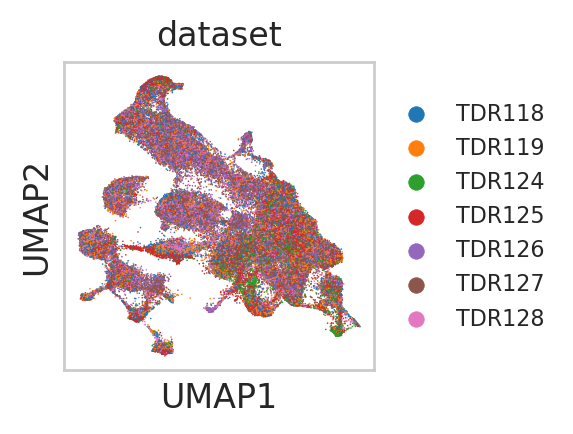

In [106]:
# UMAP (integrated_RNA) colored with batch
with plt.rc_context({"figure.figsize": (2, 2), "figure.dpi": (100)}):
    sc.pl.umap(adata_RNA_shuffled, color=["dataset"], sort_order=True,
               legend_fontsize=8,save="_integrated_rna_batch.pdf")

/hpc/user_apps/data.science/conda_envs/single-cell-base/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:1234: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
/hpc/user_apps/data.science/conda_envs/single-cell-base/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


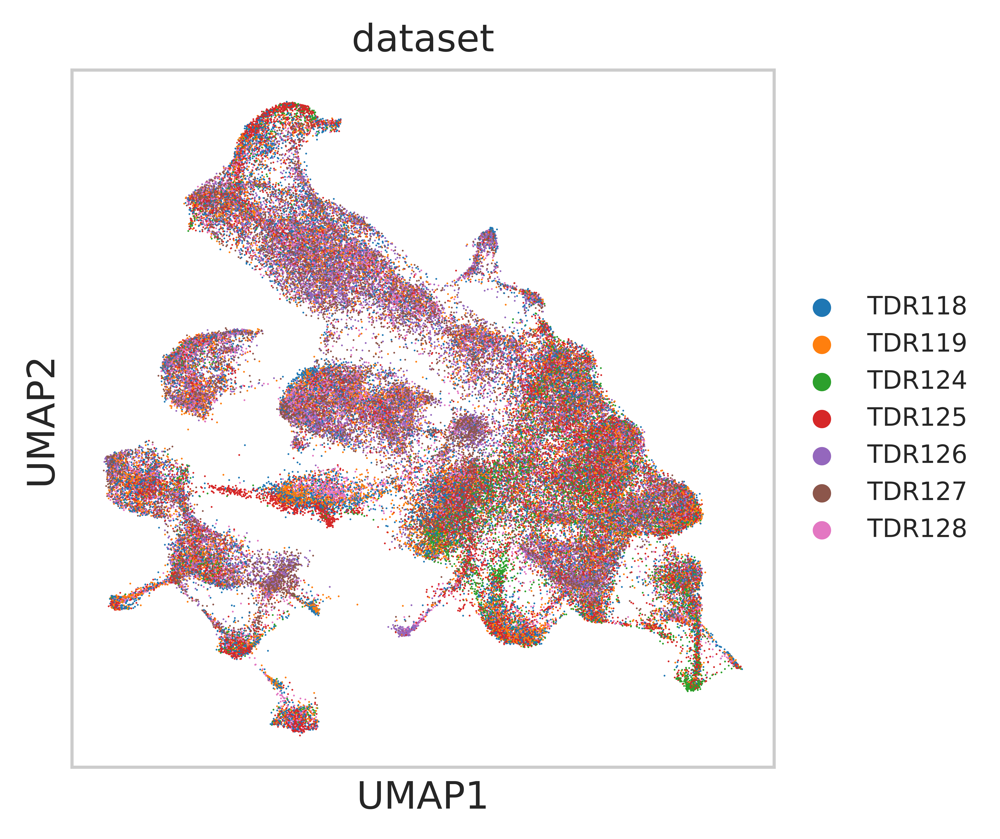

In [109]:
# UMAP (integrated_RNA) colored with batch
with plt.rc_context({"figure.figsize": (4, 4), "figure.dpi": (600)}):
    sc.pl.umap(adata_RNA_shuffled, color=["dataset"], sort_order=True,
               legend_fontsize=8,save="_integrated_rna_batch.png")

/hpc/user_apps/data.science/conda_envs/single-cell-base/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:1234: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
/hpc/user_apps/data.science/conda_envs/single-cell-base/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


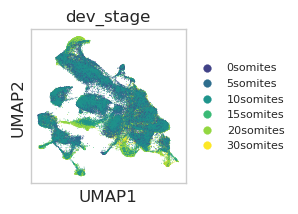

In [96]:
# UMAP (integrated_RNA) colored with "celltype annotation"
with plt.rc_context({"figure.figsize": (2, 2), "figure.dpi": (100)}):
    sc.pl.umap(adata_RNA, color=["dev_stage"], palette=color_dict,
               legend_fontsize=8,save="_integrated_rna_dev_stags.pdf")

/hpc/user_apps/data.science/conda_envs/single-cell-base/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:1234: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
/hpc/user_apps/data.science/conda_envs/single-cell-base/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


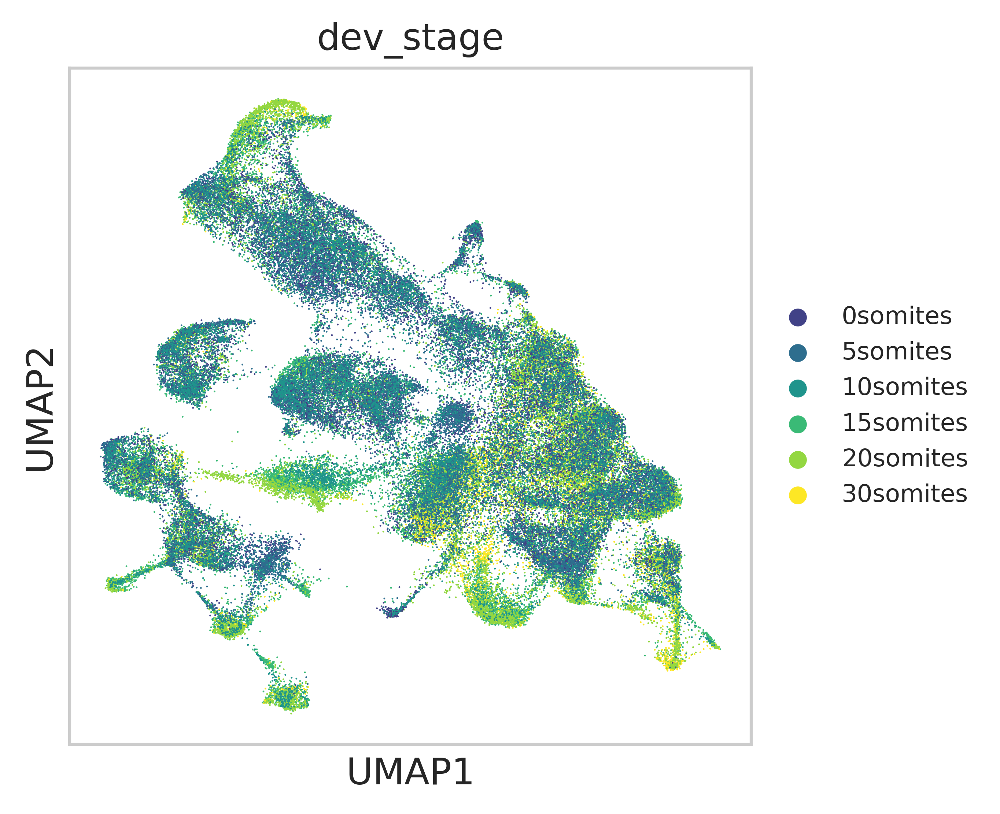

In [98]:
# UMAP (integrated_RNA) colored with "celltype annotation"
with plt.rc_context({"figure.figsize": (4, 4), "figure.dpi": (600)}):
    sc.pl.umap(adata_RNA, color=["dev_stage"], palette=color_dict,
               legend_fontsize=8,save="_integrated_rna_dev_stags.png")

## Appendix (comparison of cell type fractions between WT and meox1 KO with CellRank-predicted terminal fate probabilities)

- numbers are from Sarah's notebook: Running CellRank to predict the fraction of celltypes at their terminal fates (after enough time for differentation)

In [27]:
cell_type_fractions[cell_type_fractions.index=="TDR118"]

global_annotation,Adaxial_Cells,Differentiating_Neurons,Endoderm,Epidermal,Lateral_Mesoderm,Muscle,NMPs,Neural_Anterior,Neural_Crest,Neural_Posterior,Notochord,PSM,Somites
dataset,,,,,,,,,,,,,
TDR118,0.00957,0.023999,0.035998,0.11013,0.143846,0.033274,0.006699,0.320009,0.074205,0.127577,0.005963,0.057936,0.050795


In [30]:
cell_type_fractions[cell_type_fractions.index=="TDR118"].to_dict()

{'Adaxial_Cells': {'TDR118': 0.009570082449941108},
 'Differentiating_Neurons': {'TDR118': 0.02399882214369847},
 'Endoderm': {'TDR118': 0.0359982332155477},
 'Epidermal': {'TDR118': 0.11012956419316844},
 'Lateral_Mesoderm': {'TDR118': 0.1438457008244994},
 'Muscle': {'TDR118': 0.03327444051825677},
 'NMPs': {'TDR118': 0.006699057714958775},
 'Neural_Anterior': {'TDR118': 0.3200088339222615},
 'Neural_Crest': {'TDR118': 0.07420494699646643},
 'Neural_Posterior': {'TDR118': 0.12757656065959952},
 'Notochord': {'TDR118': 0.005962897526501767},
 'PSM': {'TDR118': 0.05793580683156655},
 'Somites': {'TDR118': 0.05079505300353357}}

In [31]:
dict_WT_fractions = {'Adaxial_Cells': 0.009570082449941108,
 'Differentiating_Neurons': 0.02399882214369847,
 'Endoderm': 0.0359982332155477,
 'Epidermal': 0.11012956419316844,
 'Lateral_Mesoderm': 0.1438457008244994,
 'Muscle': 0.03327444051825677,
 'NMPs': 0.006699057714958775,
 'Neural_Anterior': 0.3200088339222615,
 'Neural_Crest': 0.07420494699646643,
 'Neural_Posterior': 0.12757656065959952,
 'Notochord': 0.005962897526501767,
 'PSM': 0.05793580683156655,
 'Somites': 0.05079505300353357}

In [37]:
dict_meox1_KO_fractions = {
    "Adaxial_Cells":0,
    'Differentiating_Neurons':0,
    "Endoderm":0.028759,
    "Epidermal":0.056077,
    "Lateral_Mesoderm":0.113762,
    "Muscle":0.022632,
    "NMPs":0,
    "Neural_Anterior": 0.493183,
    "Neural_Crest":0.051336,
    "Neural_Posterior":0.124578,
    "Notochord":0,
    "PSM":0.068394,
    "Somites":0.041278,
}

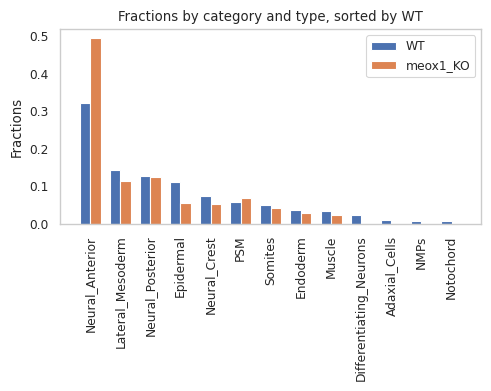

In [44]:
# Convert dictionaries to DataFrame for easier plotting
df = pd.DataFrame([dict_WT_fractions, dict_meox1_KO_fractions]).T
df.columns = ['WT', 'meox1_KO']

# Sort the DataFrame based on 'WT' values in descending order
df_sorted = df.sort_values(by='WT', ascending=False)

# Plot with sorted data
fig, ax = plt.subplots(figsize=(5, 4))

# Adjust the x locations for the groups based on the sorted data
ind_sorted = np.arange(len(df_sorted))

# Plotting both categories with sorted indices
bars1 = ax.bar(ind_sorted - width/2, df_sorted['WT'], width, label='WT')
bars2 = ax.bar(ind_sorted + width/2, df_sorted['meox1_KO'], width, label='meox1_KO')

# Add some text for labels, title and custom x-axis tick labels, etc.
ax.set_ylabel('Fractions')
ax.set_title('Fractions by category and type, sorted by WT')
ax.set_xticks(ind_sorted)
ax.set_xticklabels(df_sorted.index, rotation=90)
ax.legend()
ax.grid(False)

plt.tight_layout()
plt.show()
# # Plot
# fig, ax = plt.subplots(figsize=(10, 8))
# width = 0.35  # the width of the bars
# ind = np.arange(len(df))  # the x locations for the groups

# # Plotting both categories
# bars1 = ax.bar(ind - width/2, df['WT'], width, label='WT')
# bars2 = ax.bar(ind + width/2, df['meox1_KO'], width, label='meox1_KO')

# # Add some text for labels, title and custom x-axis tick labels, etc.
# ax.set_ylabel('Fractions')
# ax.set_title('Fractions by category and type')
# ax.set_xticks(ind)
# ax.set_xticklabels(df.index, rotation=90)
# ax.legend()


# plt.tight_layout()
# plt.show()